<a href="https://colab.research.google.com/github/fintihlupik/Airline_Classification/blob/main/Airlines_Classification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Importación de librerias

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import missingno as msno

## Carga de archivos

In [ ]:
df=pd.read_csv("https://raw.githubusercontent.com/Bootcamp-IA-P4/flight-feel-analyzer/refs/heads/dev/data/airline_passenger_satisfaction.csv")

## Exploración Inicial

In [ ]:
df.head(10)

,Unnamed: 0,id,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,...,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
0,0,70172,Male,Loyal Customer,13,Personal Travel,Eco Plus,460,3,4,...,5,4,3,4,4,5,5,25,18.0,neutral or dissatisfied
1,1,5047,Male,disloyal Customer,25,Business travel,Business,235,3,2,...,1,1,5,3,1,4,1,1,6.0,neutral or dissatisfied
2,2,110028,Female,Loyal Customer,26,Business travel,Business,1142,2,2,...,5,4,3,4,4,4,5,0,0.0,satisfied
3,3,24026,Female,Loyal Customer,25,Business travel,Business,562,2,5,...,2,2,5,3,1,4,2,11,9.0,neutral or dissatisfied
4,4,119299,Male,Loyal Customer,61,Business travel,Business,214,3,3,...,3,3,4,4,3,3,3,0,0.0,satisfied
5,5,111157,Female,Loyal Customer,26,Personal Travel,Eco,1180,3,4,...,1,3,4,4,4,4,1,0,0.0,neutral or dissatisfied
6,6,82113,Male,Loyal Customer,47,Personal Travel,Eco,1276,2,4,...,2,3,3,4,3,5,2,9,23.0,neutral or dissatisfied
7,7,96462,Female,Loyal Customer,52,Business travel,Business,2035,4,3,...,5,5,5,5,4,5,4,4,0.0,satisfied
8,8,79485,Female,Loyal Customer,41,Business travel,Business,853,1,2,...,1,1,2,1,4,1,2,0,0.0,neutral or dissatisfied
9,9,65725,Male,disloyal Customer,20,Business travel,Eco,1061,3,3,...,2,2,3,4,4,3,2,0,0.0,neutral or dissatisfied


In [ ]:
print('La forma del dataset es', df.shape)
print('Rows duplicadas en train dataset :', df.duplicated().sum() )

La forma del dataset es (103904, 25)
Rows duplicadas en train dataset : 0


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 103904 entries, 0 to 103903
Data columns (total 25 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   Unnamed: 0                         103904 non-null  int64  
 1   id                                 103904 non-null  int64  
 2   Gender                             103904 non-null  object 
 3   Customer Type                      103904 non-null  object 
 4   Age                                103904 non-null  int64  
 5   Type of Travel                     103904 non-null  object 
 6   Class                              103904 non-null  object 
 7   Flight Distance                    103904 non-null  int64  
 8   Inflight wifi service              103904 non-null  int64  
 9   Departure/Arrival time convenient  103904 non-null  int64  
 10  Ease of Online booking             103904 non-null  int64  
 11  Gate location                      1039

In [ ]:
%%capture
!pip install ydata-profiling
from ydata_profiling import ProfileReport
from IPython.display import HTML # import the HTML object

In [ ]:
profile_change = ProfileReport(df,title="Airlines Satisfaction. Profiling Report", explorative=True,)
profile_change.to_file("output_change.html")
HTML(filename='output_change.html')

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 25/25 [00:02<00:00, 10.05it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

## Borrar unnamed y id, son inútiles

In [ ]:
df = df.drop(df.iloc[:,[0, 1]], axis = 1)

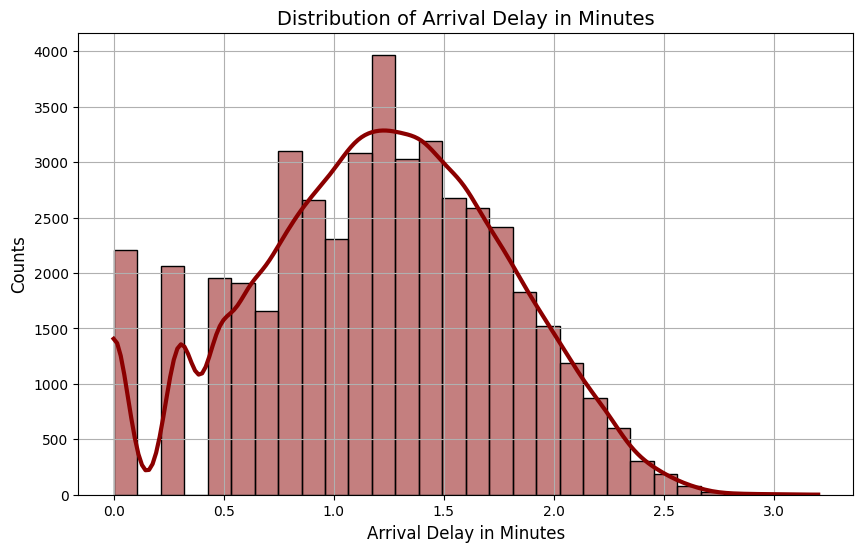

In [ ]:
def plot_num_distribution(df, target_column):

    plt.figure(figsize=(10, 6))

    sns.histplot(
        np.log10(df[target_column]),
        #df[target_column],
        stat='count',
        kde=True,
        bins=30,
        color='darkred',
        line_kws = {'lw':3})

    plt.title(f'Distribution of {target_column}', fontsize=14)
    plt.xlabel(target_column, fontsize=12)
    plt.ylabel('Counts', fontsize=12)
    plt.grid(True)
    plt.show()

plot_num_distribution(df, 'Arrival Delay in Minutes')

In [ ]:
mean_delay = df['Arrival Delay in Minutes'].mean()
median_delay = df['Arrival Delay in Minutes'].median()
mode_delay = df['Arrival Delay in Minutes'].mode()

print(f"Media: {mean_delay}")
print(f"Mediana: {median_delay}")
print(f"Moda: {mode_delay.tolist()}")


Media: 15.178678301832152
Mediana: 0.0
Moda: [0.0]
